The Lunar Crater Project, mentored by Dr. David Kipping at The Cool Worlds group, simulates the formation and distribution of craters on the moon's surface. Using an inverse cumulative distribution function (CDF), the simulation generates crater sizes within specified bounds and places them at random longitudes and latitudes, following a Poisson distribution for new craters over time. The project seeks to evaluate moon base safety, the survival of hypothetical alien artifacts, and human time capsules, and assess potential threats to lunar settlements.

In [1]:
# Imports
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.optimize import minimize
import pandas as pd

Parameters of the Simulation

In [2]:
time_steps = 10
tau = 100  # Time constant in millions of years
desired_total_craters = 2_000_000  # Desired total number of craters

# More dimensions
a = 0.498
dmin = 0.27  # Minimum crater size in kilometers
dmax = 1100  # Maximum crater size in kilometers

Functions

In [3]:
"""
Calculates the inverse cdf.
Args:
    p:Rrandom probability between 0-1 that is necessary to use the inverse CDF
    dmin: Minimum diameter of simulated craters
    dmax: Maximum diameter of simulated craters
    a: Describes the relationship between the size of craters and their relative abundances.There is a steeper decline in the number of craters as the crater size increases. This suggests that smaller craters are much more common than larger ones. Conversely, the smaller the a, the less steep the decline in the number of craters as crater size increases. 
Returns: Inverse cdf

"""
def inverse_cdf(p, dmin, dmax, a):
    q = dmin * (1-p)**(-1/a)
    return np.minimum(q, dmax)  # Ensures that no crater is larger than dmax

"""
Calculates and returns the optimal lmbdanot, which is the initial cratering rate.
Args:
    tau: Describes the decay of the cratering rate. A greater tau value means a slower decay of the cratering rate, a more even distribution of craters in each time step. A smaller tau suggests a faster decay in cratering rate, meaning more of the craters will be formed earlier.
    number_of_steps: The total time for the simulation (2 billion years) is divided into equal timesteps
    N_total_goal: The total number of craters that will be simulated
Returns: Lmbdanot the initial cratering rate

"""
def lmbdanot(tau, number_of_steps, N_total_goal):
    return N_total_goal / ((np.exp(-(number_of_steps/tau)) * (-1 + np.exp(number_of_steps/tau))) / (-1 + np.exp(1/tau)))

In [14]:
"""
Simulates craters creates a visual plot at each time step, using a different color for each timestep.
Args: 
    lmbda_0: The inital cratering rate of the simulation
Returns: Plots at every timestep showcasing the simulated craters and prints the toal number of craters at each timestep
"""

def simulate_craters(lmbda_0):
    # Array to store the total number of craters and their positions at each time step
    craters = np.zeros(time_steps)
    crater_positions = []

    for t in range(time_steps):
        # Current cratering rate
        lambda_ = lmbda_0 * np.exp(-t / tau)
        # Simulate number of new craters at this time step
        new_craters = int(np.random.poisson(lambda_))
        # Generate random longitude for each new crater (in radians)
        longitudes = np.random.uniform(-np.pi, np.pi, size=new_craters)
        # Generate latitudes using arcsin to reflect fewer craters near the poles (in radians)
        latitudes = np.arcsin(np.random.uniform(-1, 1, size=new_craters))
        # Generate sizes using the inverse CDF
        u = np.random.uniform(size=new_craters)
        sizes = inverse_cdf(u, dmin, dmax, a)
        # Put the longitudes, latitudes, and sizes together
        new_crater_data = np.column_stack((longitudes, latitudes, sizes))
        # Append to the list of crater data
        crater_positions.append(new_crater_data)
        # Add the new craters to the total
        craters[t] = craters[t-1] + new_craters if t > 0 else new_craters

    # Print the total number of craters at each time step
    for t in range(time_steps):
        print(f'After {t*100} million years: {craters[t]} craters')
    # Create a color map for the different time steps, different color for each time
    colors = cm.gist_rainbow(np.linspace(0, 1, time_steps))
    # Scaling factor for the crater sizes
    size_scale_factor = .001
    for t in range(time_steps):
        # Plot the results
        plt.figure(figsize=(10, 6))

        for t_past in range(t+1):
            plt.scatter(np.degrees(crater_positions[t_past][:, 0]), np.degrees(crater_positions[t_past][:, 1]),
                        s=crater_positions[t_past][:, 2]*size_scale_factor,
                        color=colors[t_past], alpha=0.6, label=f'{t_past*200} million years')

        plt.xlabel('Longitude (degrees)')
        plt.ylabel('Latitude (degrees)')
        plt.title(f'Cratering over time on the moon\'s surface after {t*200} million years')
        plt.xlim([-180, 180])
        plt.ylim([-90, 90])

        plt.legend()
        plt.show()

    return craters, crater_positions


Create CSV file with Lon, Lat, Diameter, and Timestep
IMPORTANT : Saves lon and lat in terms of radians. Surviving crater code converts it to degrees.

In [5]:
"""
Creates a CSV file of the simulated craters. There are 4 columns, latitude, longitude, diameter, and timestep.
Args: 
    lmbda_0: The inital cratering rate of the simulation
Returns: CSV file of the simulated craters with 4 columns: latitude, longitude, diameter, and timestep.
"""

def create_csv(lmbda_0, csv_filename):
    # Array to store the total number of craters and their positions at each time step
    craters = np.zeros(time_steps)
    crater_data = []

    for t in range(time_steps):
        # Current cratering rate
        lambda_ = lmbda_0 * np.exp(-t / tau)
        # Simulate number of new craters at this time step
        new_craters = int(np.random.poisson(lambda_))
        # Generate random longitude and latitude for each new crater
        longitudes = np.random.uniform(-np.pi, np.pi, size=new_craters)
        latitudes = np.arcsin(np.random.uniform(-1, 1, size=new_craters))
        # Generate sizes using the inverse CDF
        u = np.random.uniform(size=new_craters)
        sizes = inverse_cdf(u, dmin, dmax, a)
        # Put the longitudes, latitudes, sizes, and timestep together
        new_crater_data = np.column_stack((longitudes, latitudes, sizes, np.full(new_craters, t)))
        # Append to the list of crater data
        crater_data.extend(new_crater_data.tolist())
        # Add the new craters to the total
        craters[t] = craters[t-1] + new_craters if t > 0 else new_craters

    # Save data to a CSV file
    directory = r'C:\Users\julia\OneDrive\Documents\Lunar Cratering project David Kipping\Simulation CSV files'
    csv_path = f'{directory}\\{csv_filename}'
    crater_df = pd.DataFrame(crater_data, columns=['Longitude', 'Latitude', 'Size', 'TimeStep'])
    crater_df.to_csv(csv_path, index=False)

    return craters, crater_data

In [6]:
# Solve for lmbdanot
lmbda_0 = lmbdanot(tau, time_steps, 2000000)

In [10]:
# Create csv file 
csv_filename = 'craters_2000.csv'
craters, crater_data = create_csv(lmbda_0, csv_filename)

After 0 million years: 211321.0 craters
After 100 million years: 420152.0 craters
After 200 million years: 627175.0 craters
After 300 million years: 832076.0 craters
After 400 million years: 1035207.0 craters
After 500 million years: 1236234.0 craters
After 600 million years: 1435433.0 craters
After 700 million years: 1632541.0 craters
After 800 million years: 1827816.0 craters
After 900 million years: 2020744.0 craters


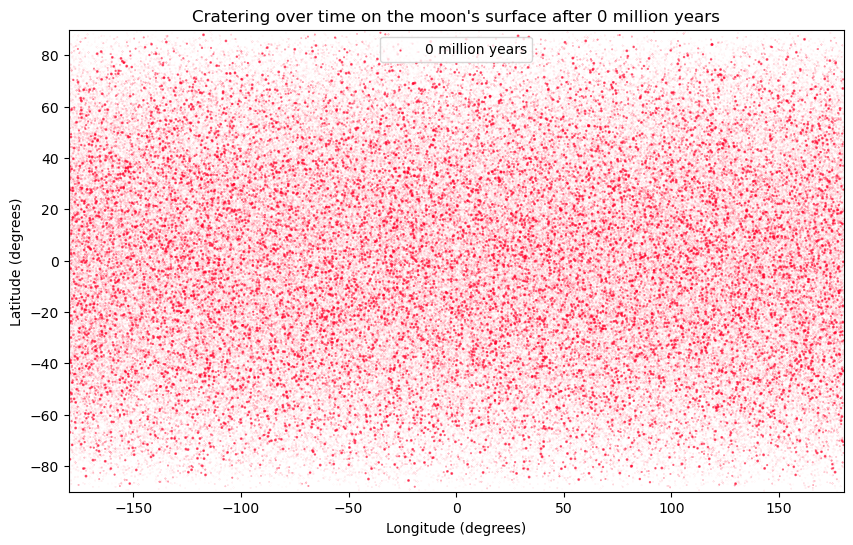

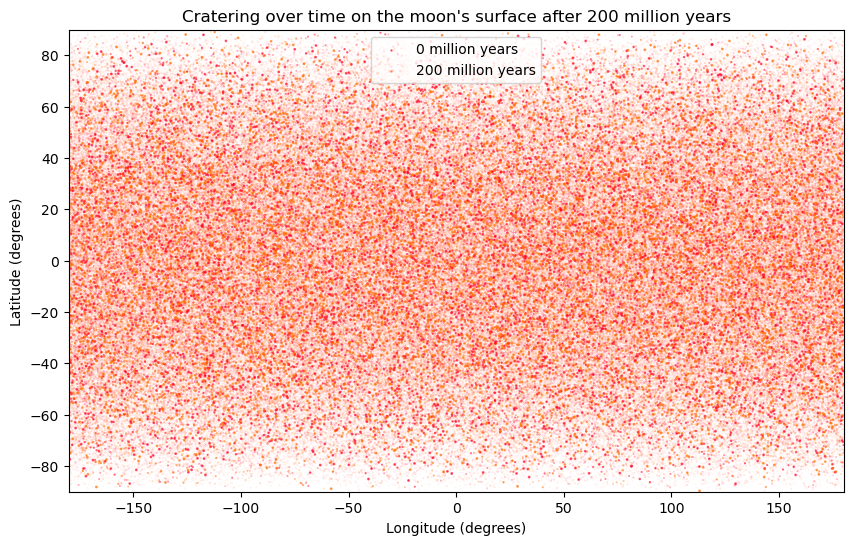

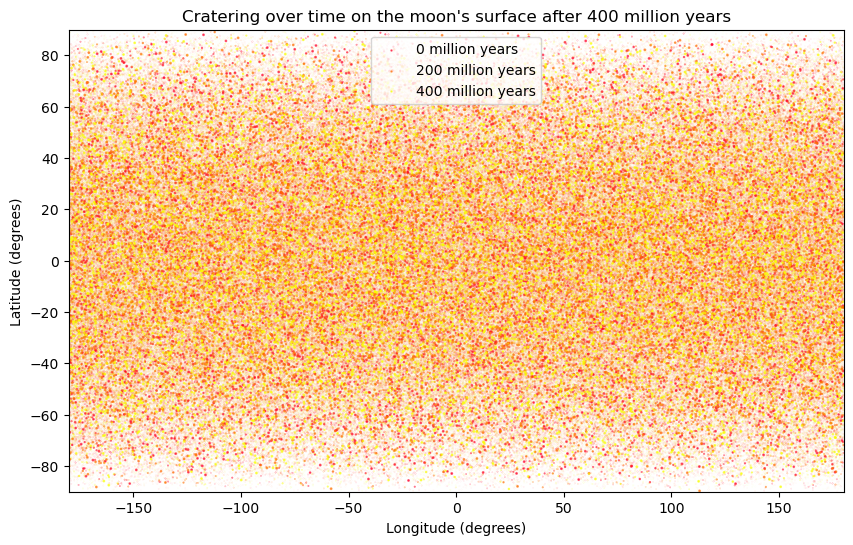

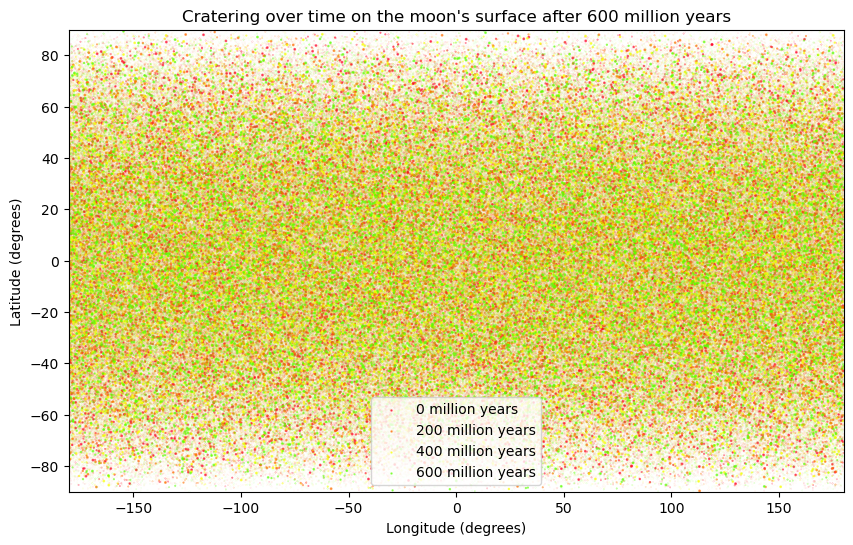

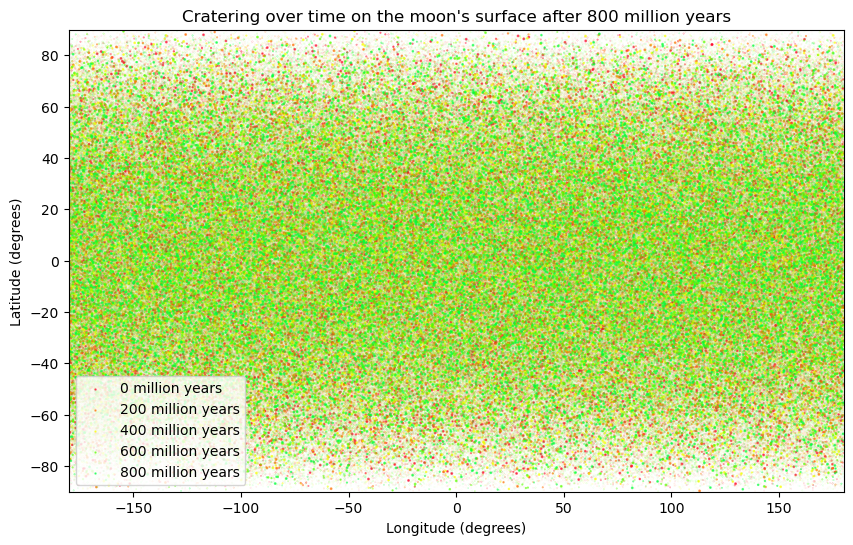

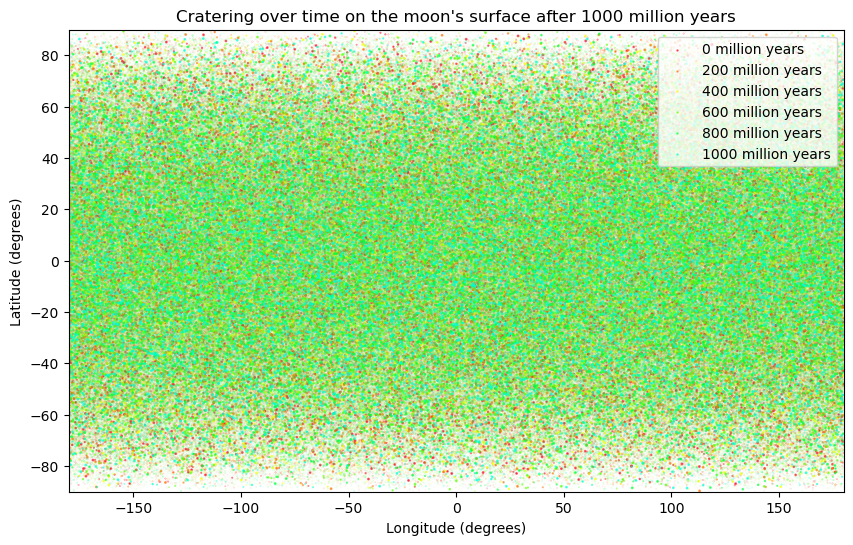

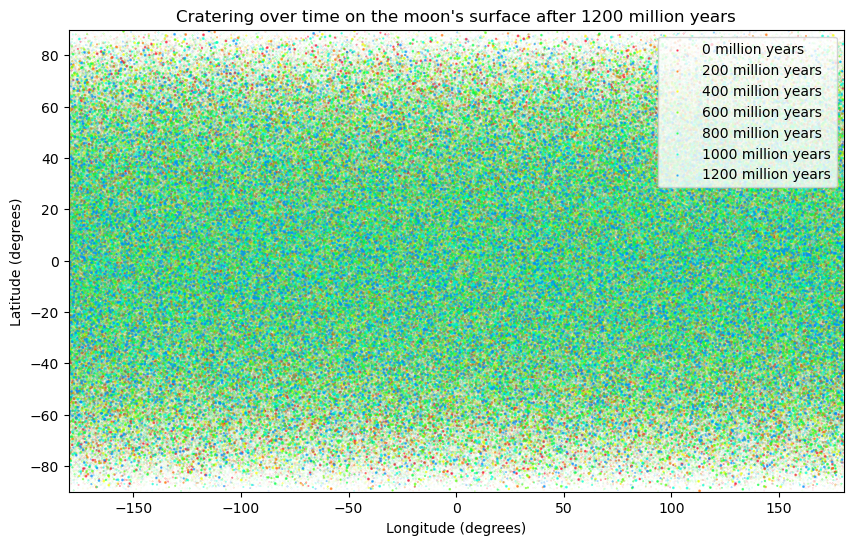

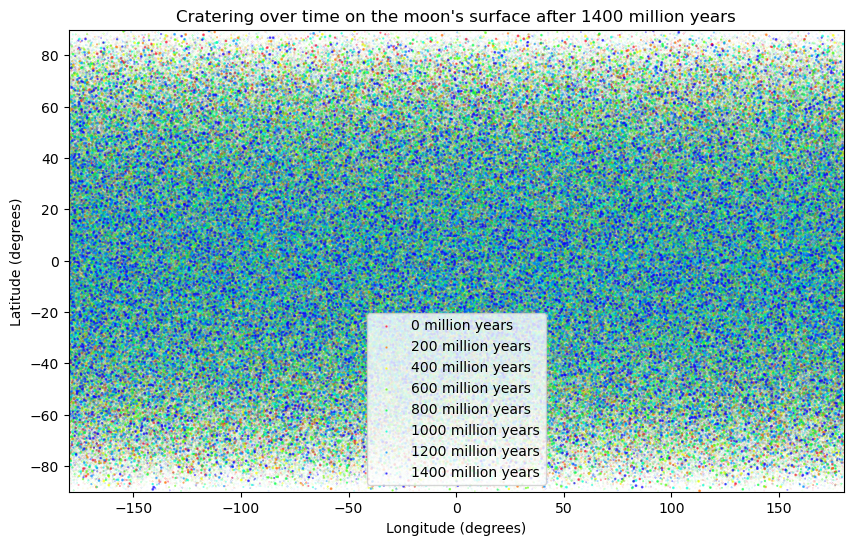

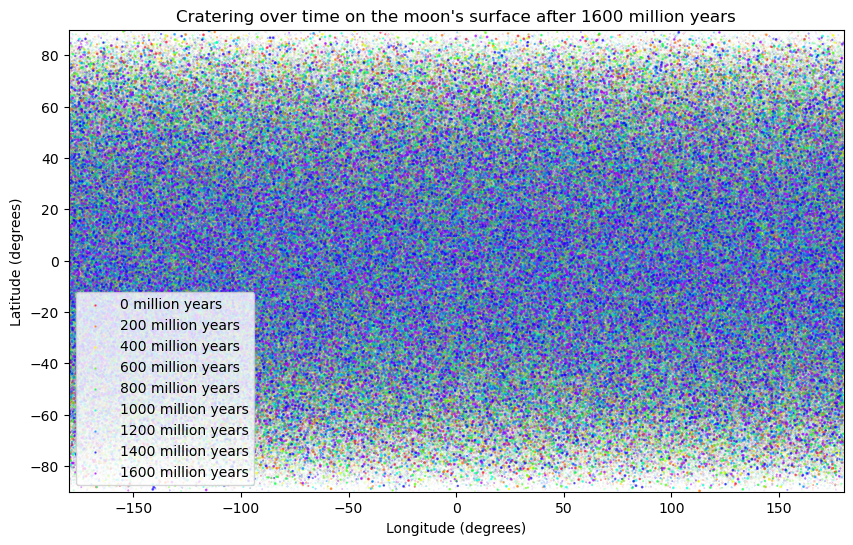

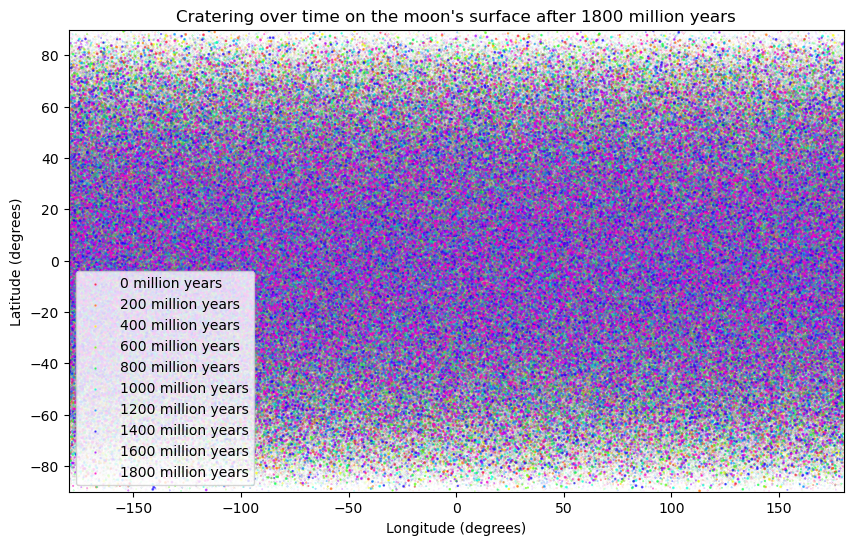

(array([ 211321.,  420152.,  627175.,  832076., 1035207., 1236234.,
        1435433., 1632541., 1827816., 2020744.]),
 [array([[-0.25530488,  0.67925121,  3.43687468],
         [-1.96069253,  0.50863701,  0.92824416],
         [-0.81101822,  0.42498773,  1.88676079],
         ...,
         [-0.45316199,  0.15248097,  0.4195255 ],
         [-0.61247538, -0.72253097,  0.94213104],
         [-1.55575558,  0.68621466,  0.30475599]]),
  array([[-0.100121  ,  0.50805244,  0.33651957],
         [ 2.76159496,  1.14628743, 72.30888034],
         [ 1.66123821, -1.31151038,  6.79645648],
         ...,
         [-1.37726367, -1.27384743,  2.14366548],
         [ 2.11775465,  0.22053959,  0.48980608],
         [ 0.66461148, -0.78228993, 13.52435126]]),
  array([[ 1.71059704, -0.31574584,  1.02312834],
         [-0.77461286, -1.26463602,  0.35246113],
         [ 2.8095204 ,  1.05409888,  1.11378994],
         ...,
         [-1.17263653, -1.14439291,  7.38236773],
         [-0.93669883, -0.02471718, 

In [15]:
# Run the simulation, 2 million craters, 10 timesteps
simulate_craters(lmbda_0)

After 0 million years: 206.0 craters
After 100 million years: 431.0 craters
After 200 million years: 638.0 craters
After 300 million years: 827.0 craters
After 400 million years: 1033.0 craters
After 500 million years: 1250.0 craters
After 600 million years: 1448.0 craters
After 700 million years: 1660.0 craters
After 800 million years: 1857.0 craters
After 900 million years: 2047.0 craters


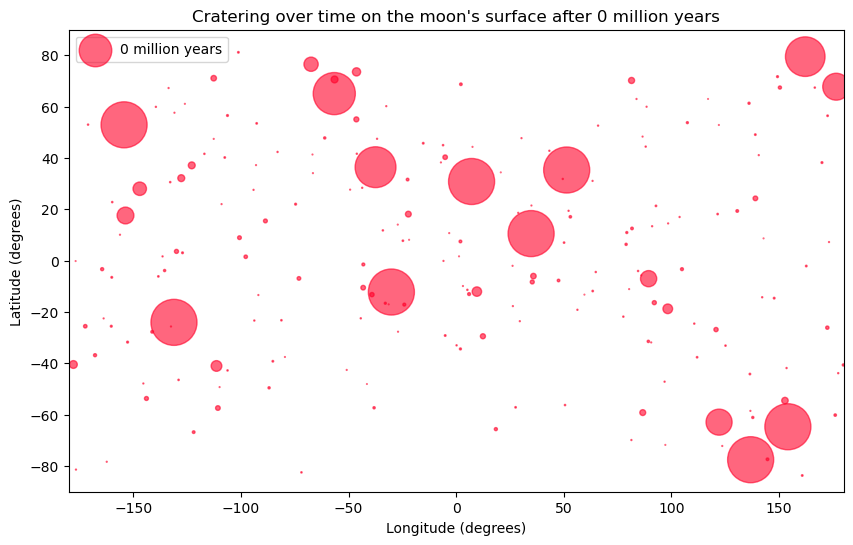

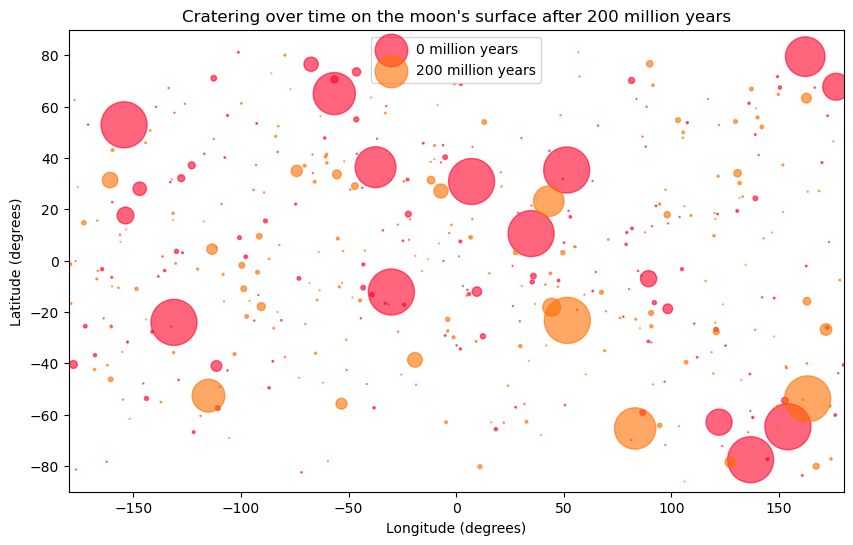

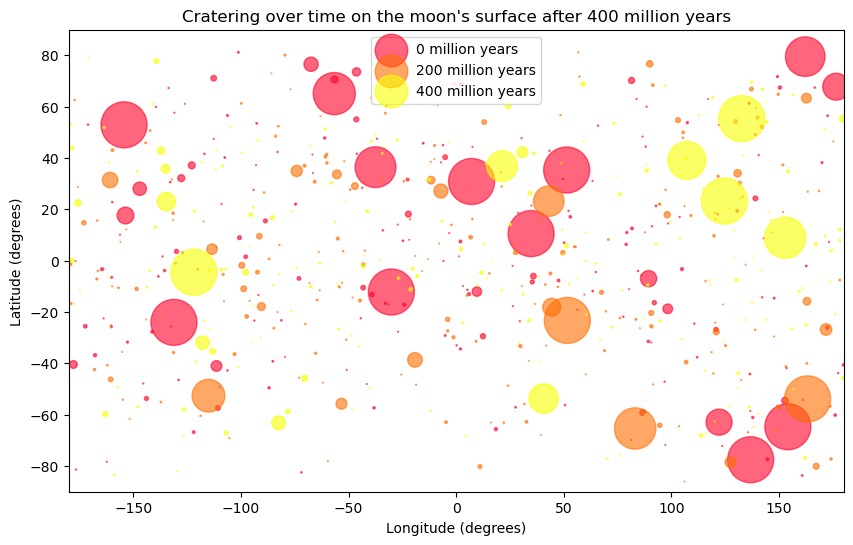

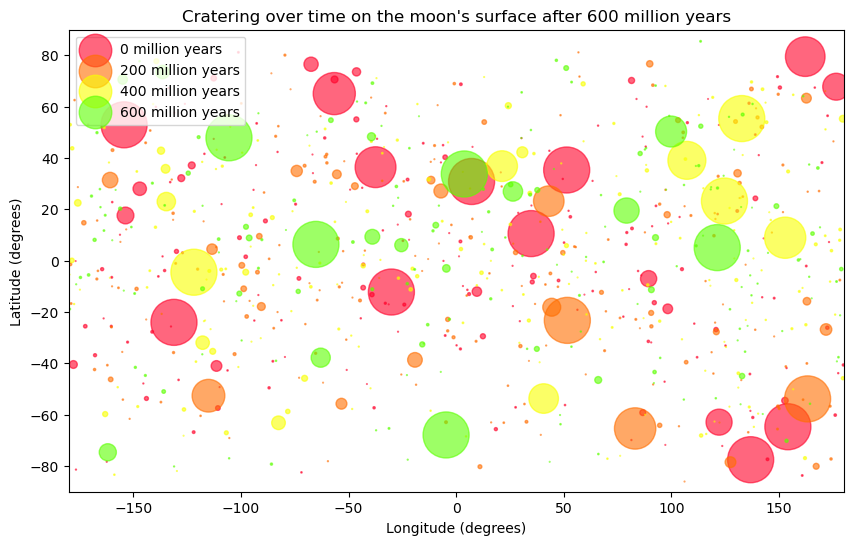

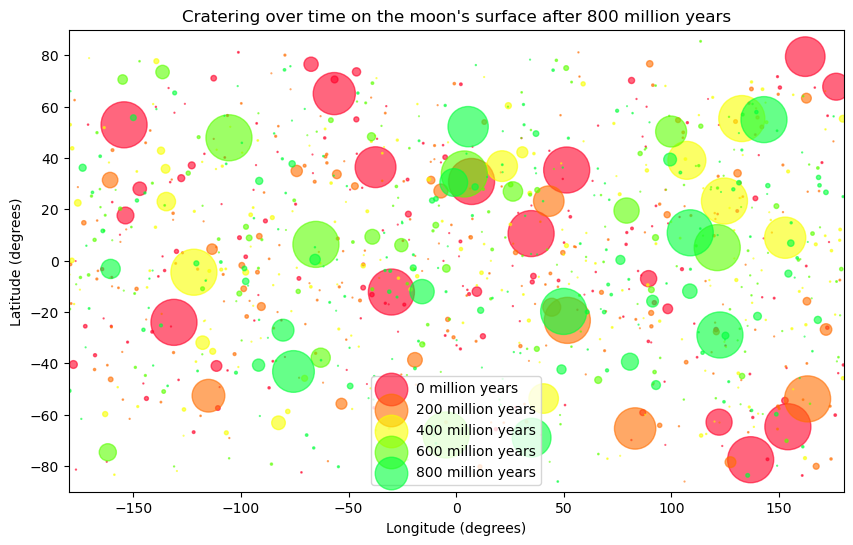

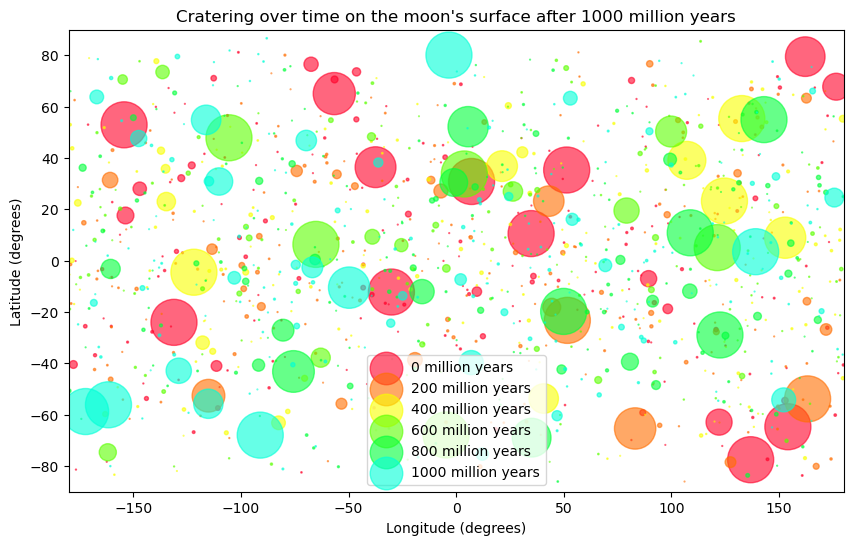

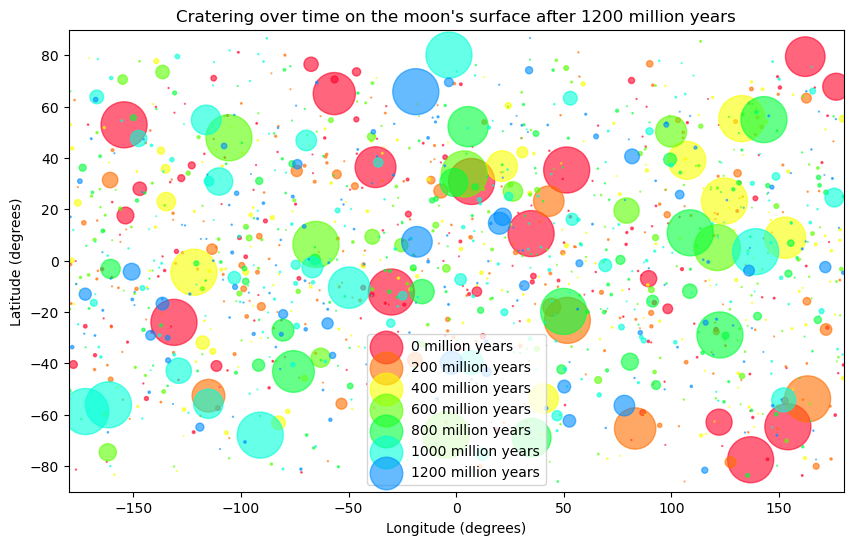

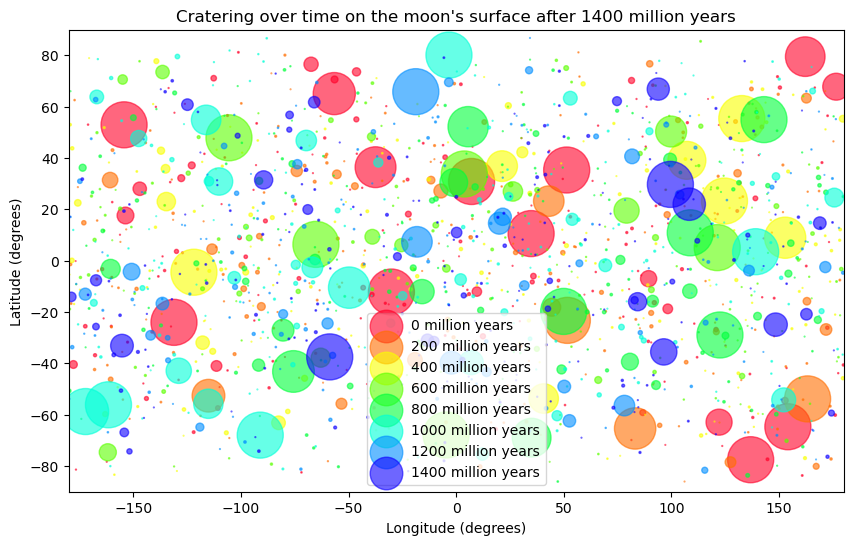

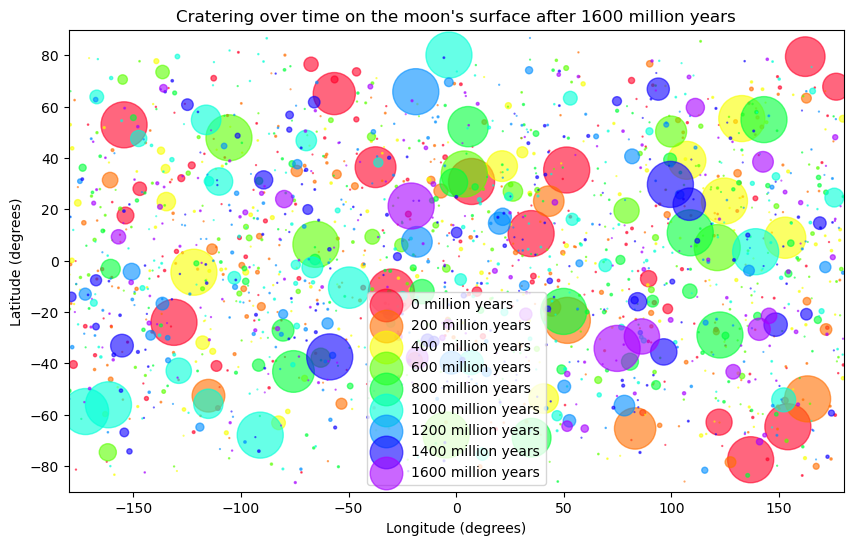

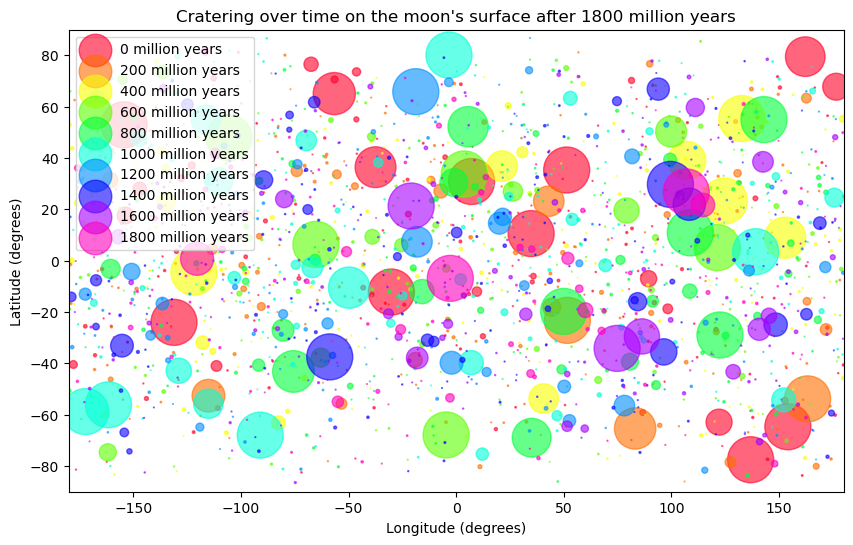

In [33]:
# Run simulation, 2000 craters, 10 timesteps
lmbda_0_2 = lmbdanot(tau, 10, 2_000)
craters, crater_positions = simulate_craters1(lmbda_0_2)

In [39]:
# Creating csv files of 1000, 10,000, and 100,000 craters

csv_filename1k = 'craters_1k.csv'
csv_filename10k = 'craters_10k.csv'
csv_filename100k = 'craters_100k.csv'

lmbda_0_1k = lmbdanot(tau, 10, 1_000)
craters, crater_data = create_csv(lmbda_0_1k, csv_filename1k)
lmbda_0_10k = lmbdanot(tau, 10, 10_000)
craters, crater_data = create_csv(lmbda_0_10k, csv_filename10k)
lmbda_0_100k = lmbdanot(tau, 10, 100_000)
craters, crater_data = create_csv(lmbda_0_100k, csv_filename100k)

After 0 million years: 92.0 craters
After 100 million years: 180.0 craters
After 200 million years: 272.0 craters
After 300 million years: 375.0 craters
After 400 million years: 478.0 craters
After 500 million years: 575.0 craters
After 600 million years: 671.0 craters
After 700 million years: 769.0 craters
After 800 million years: 865.0 craters
After 900 million years: 959.0 craters


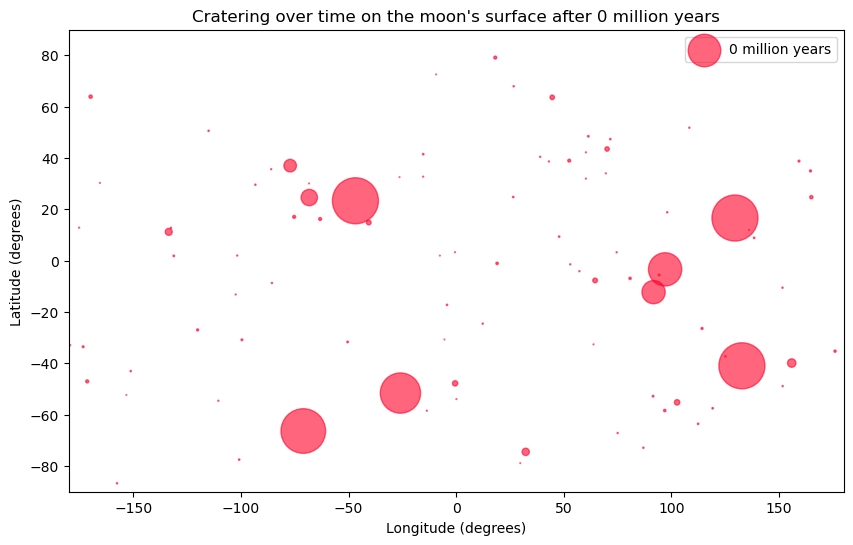

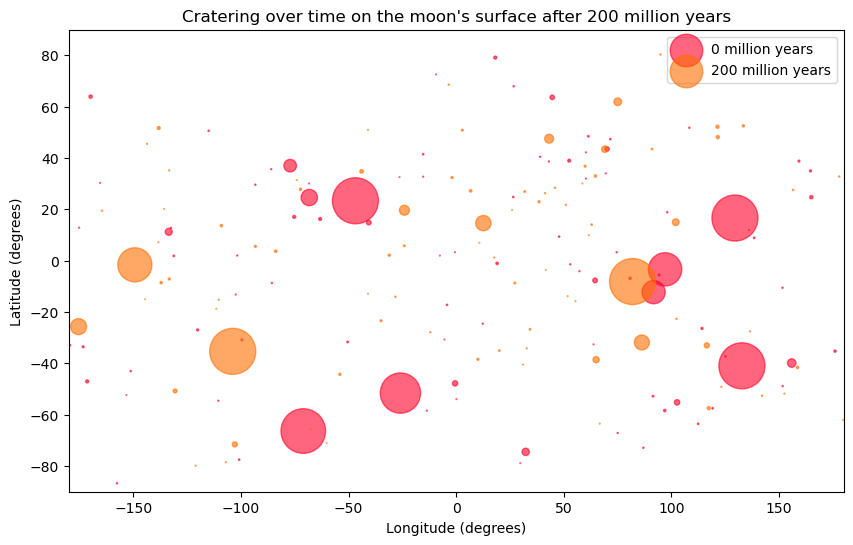

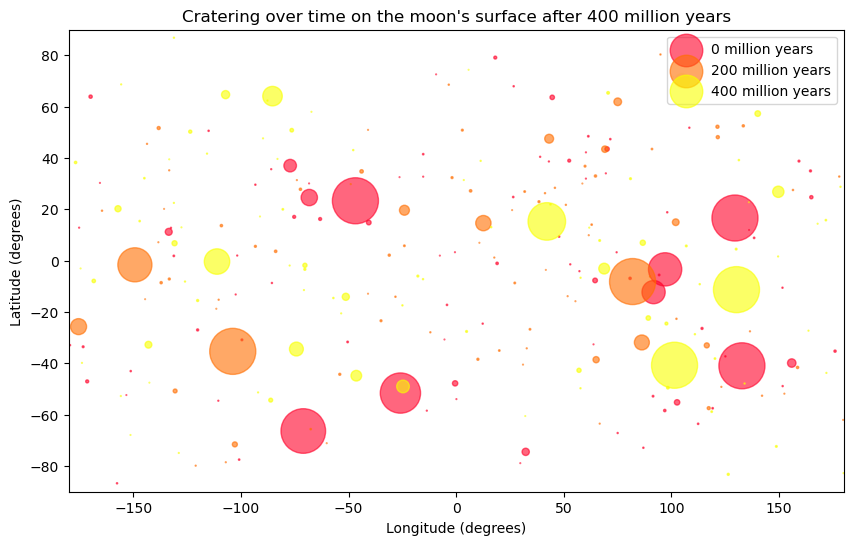

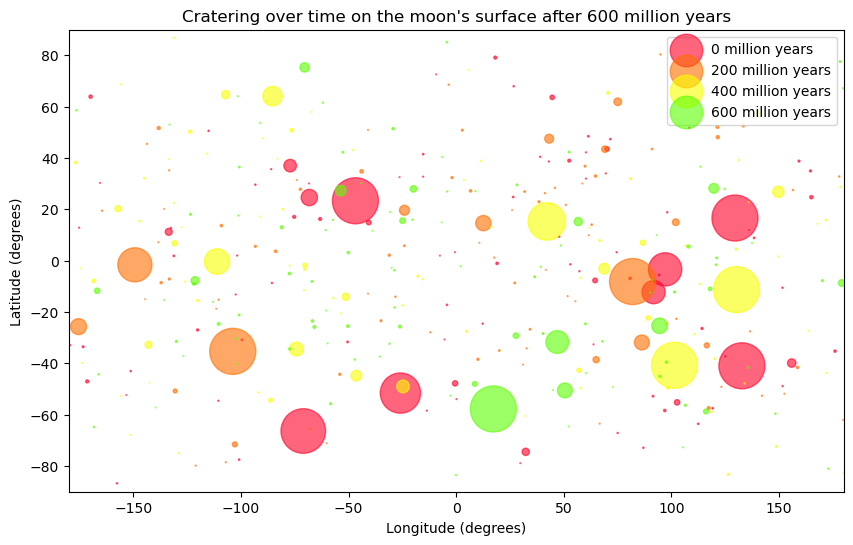

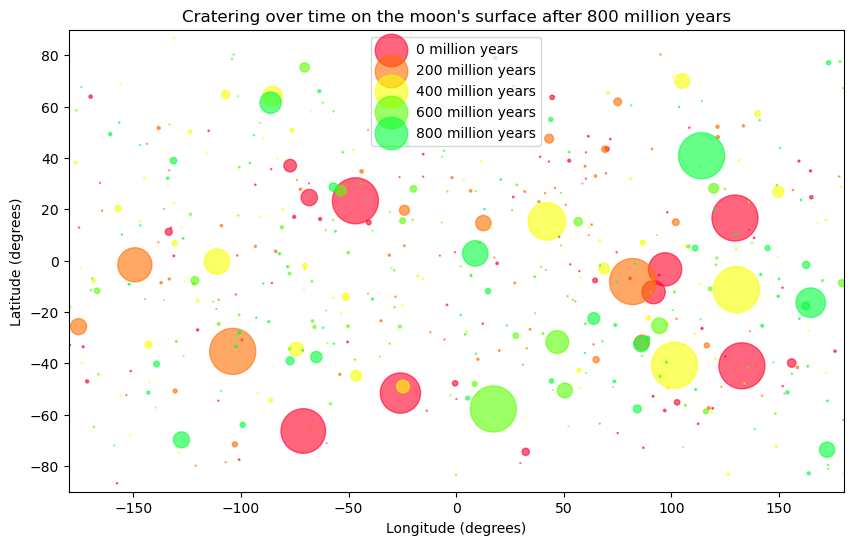

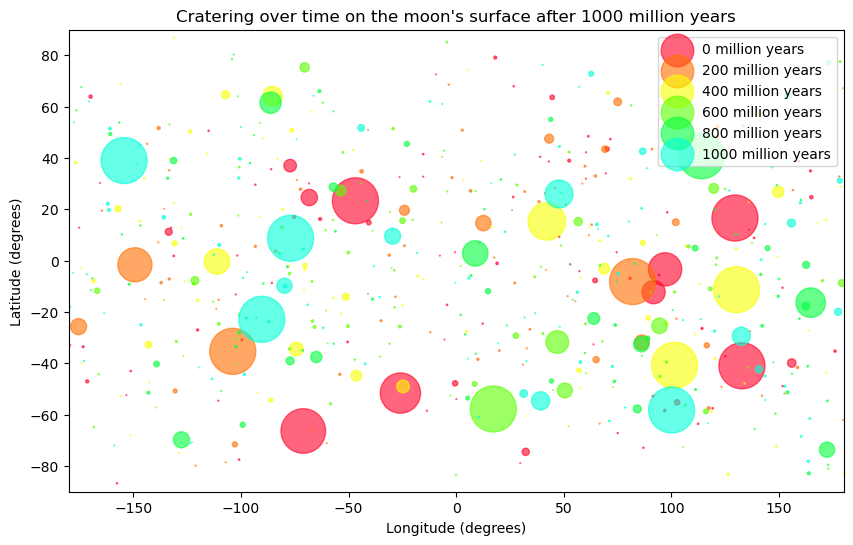

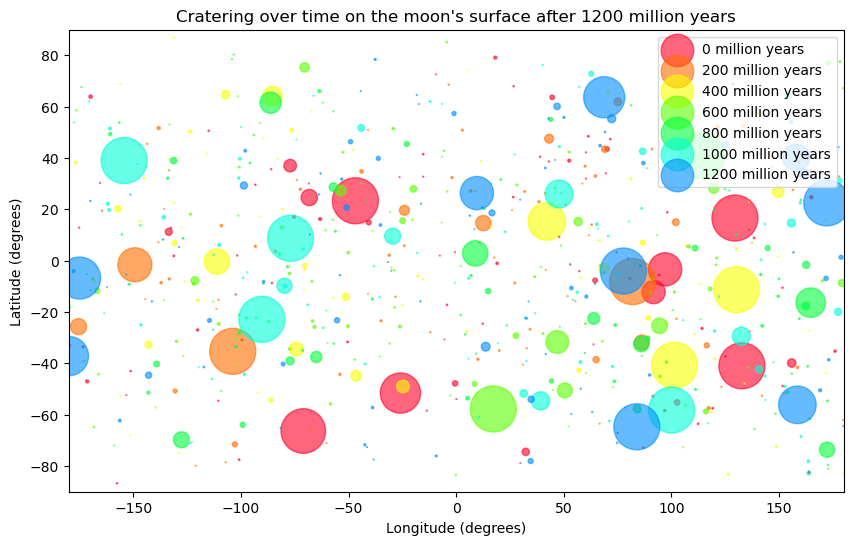

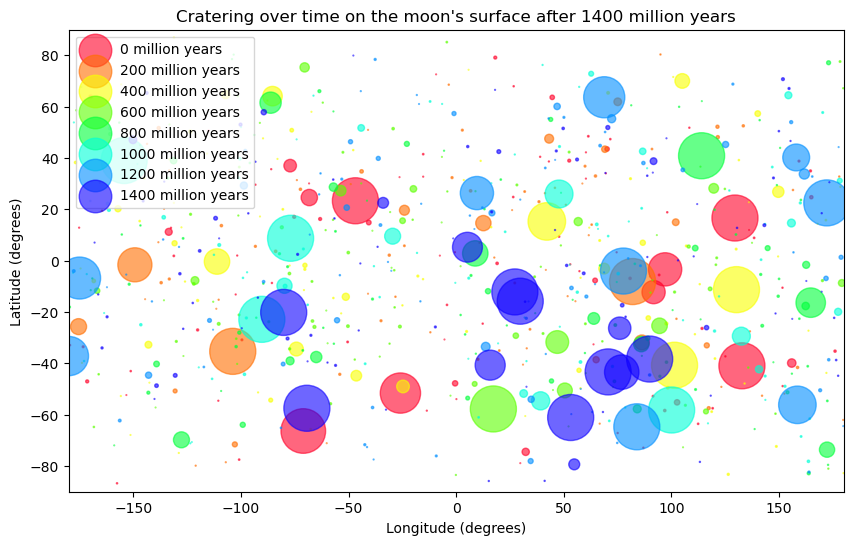

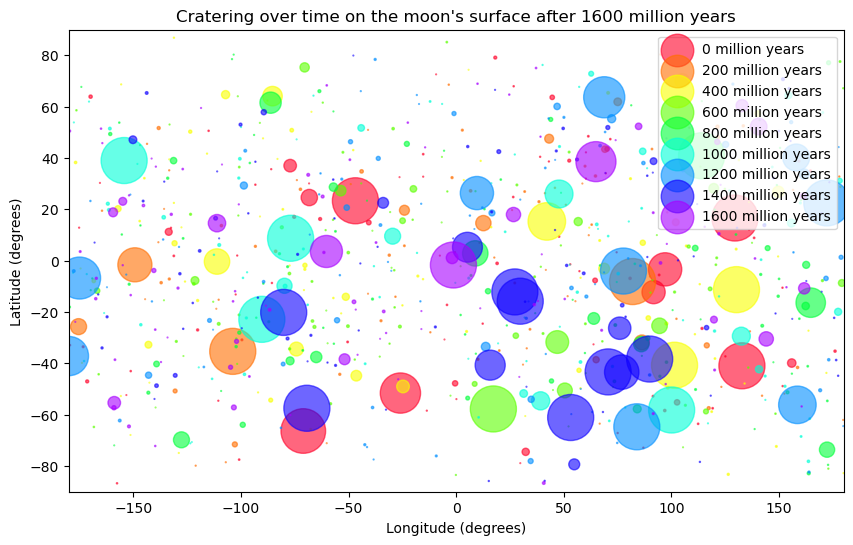

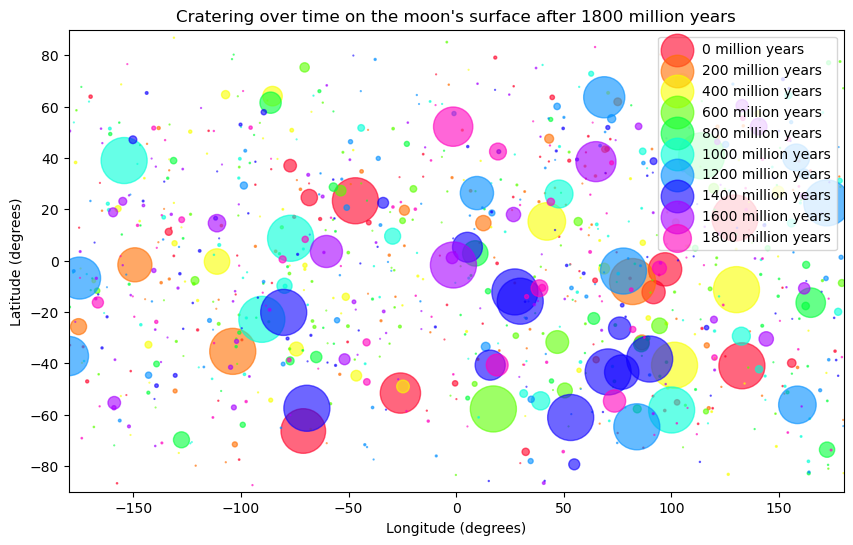

In [45]:
# Run simulation for 1000 craters, 20 timesteps
craters, crater_positions = simulate_craters1(lmbda_0_1k)

After 0 million years: 1073.0 craters
After 100 million years: 2107.0 craters
After 200 million years: 3104.0 craters
After 300 million years: 4189.0 craters
After 400 million years: 5235.0 craters
After 500 million years: 6200.0 craters
After 600 million years: 7194.0 craters
After 700 million years: 8192.0 craters
After 800 million years: 9181.0 craters
After 900 million years: 10145.0 craters


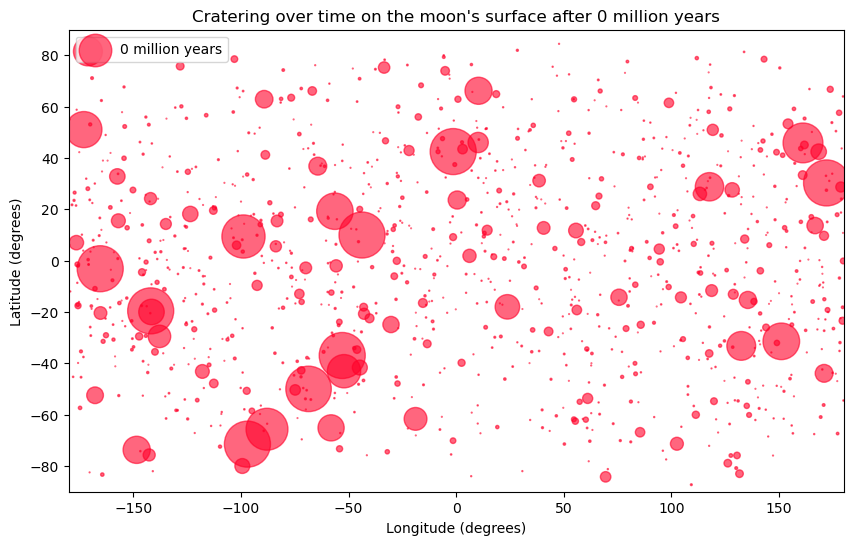

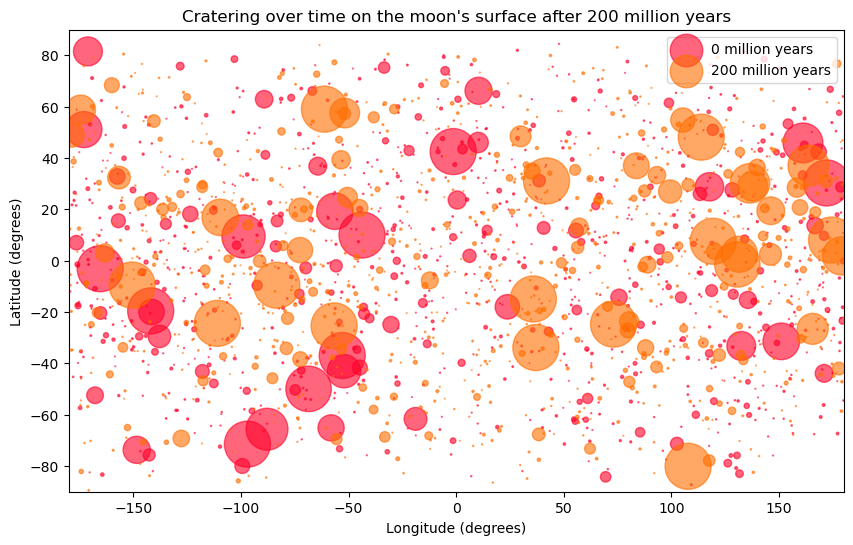

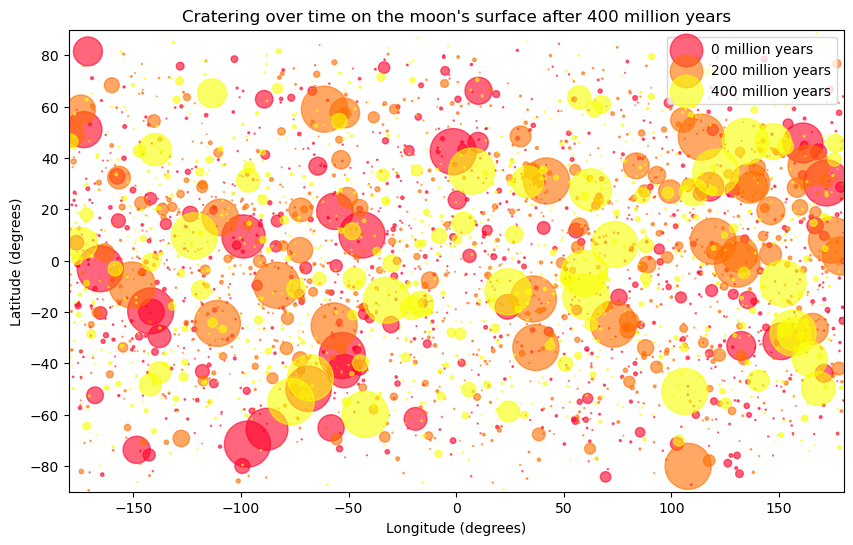

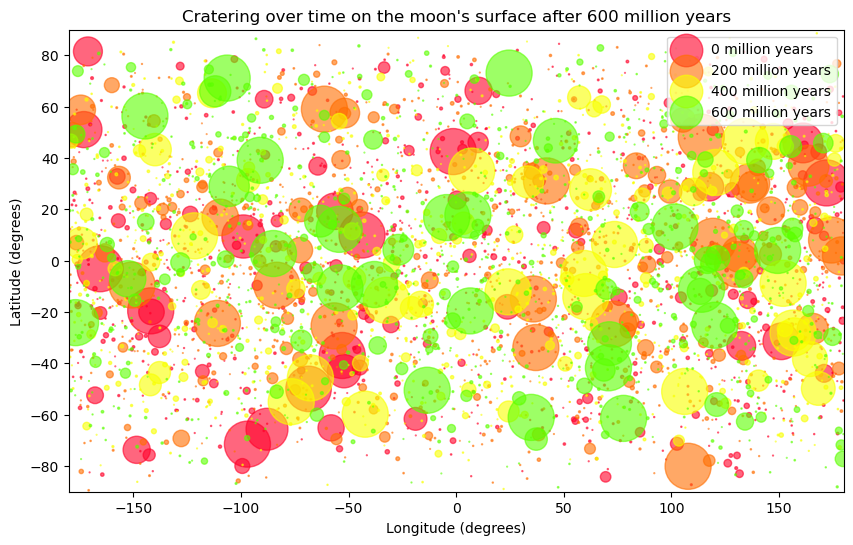

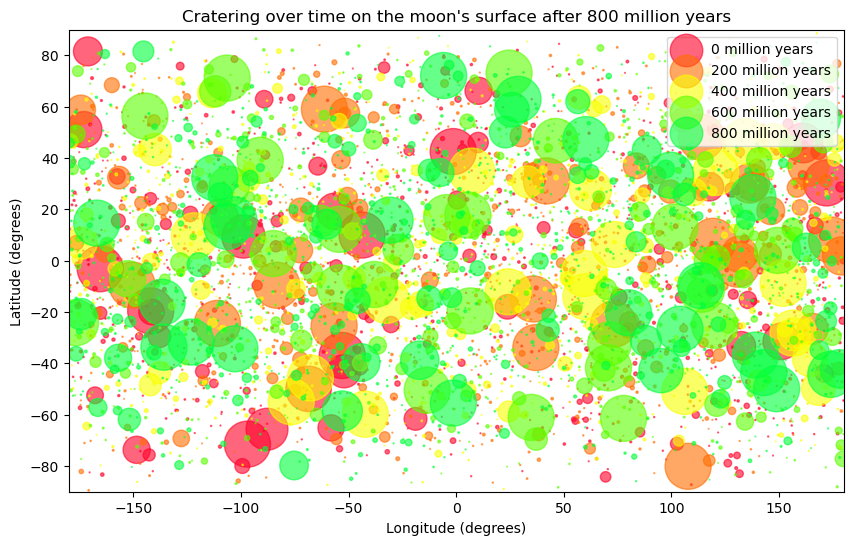

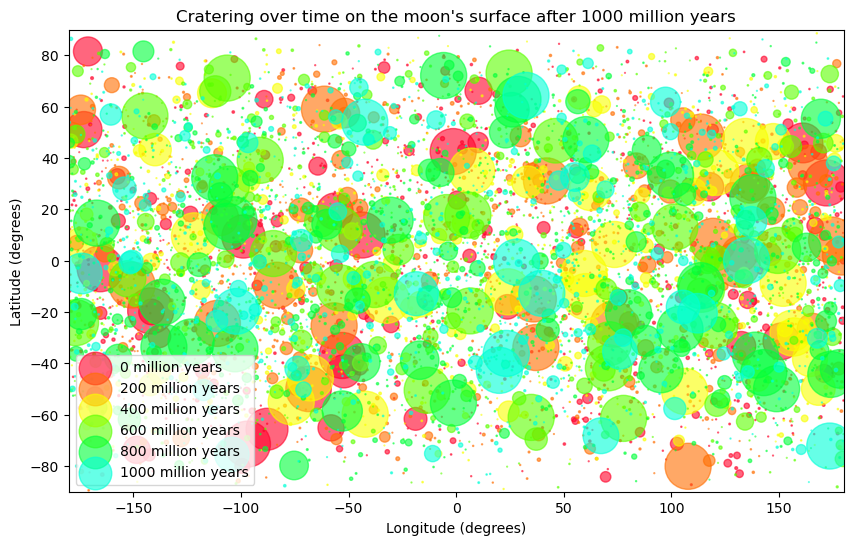

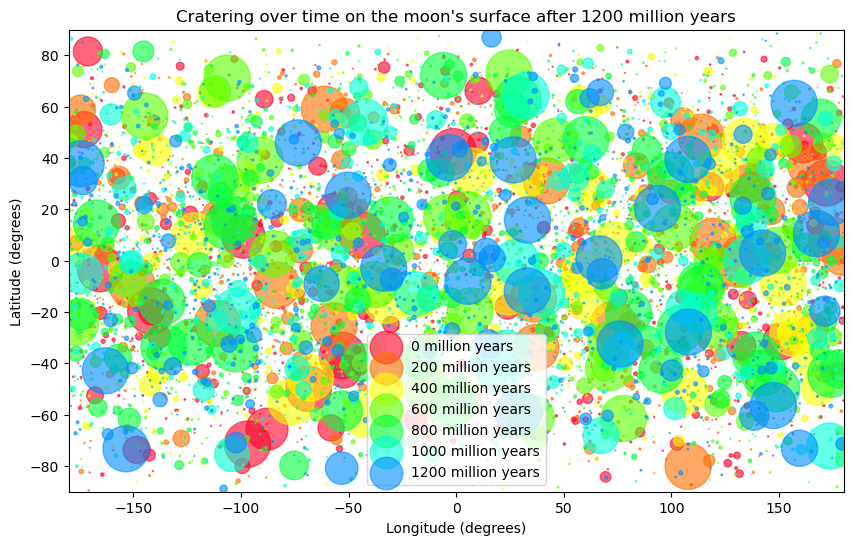

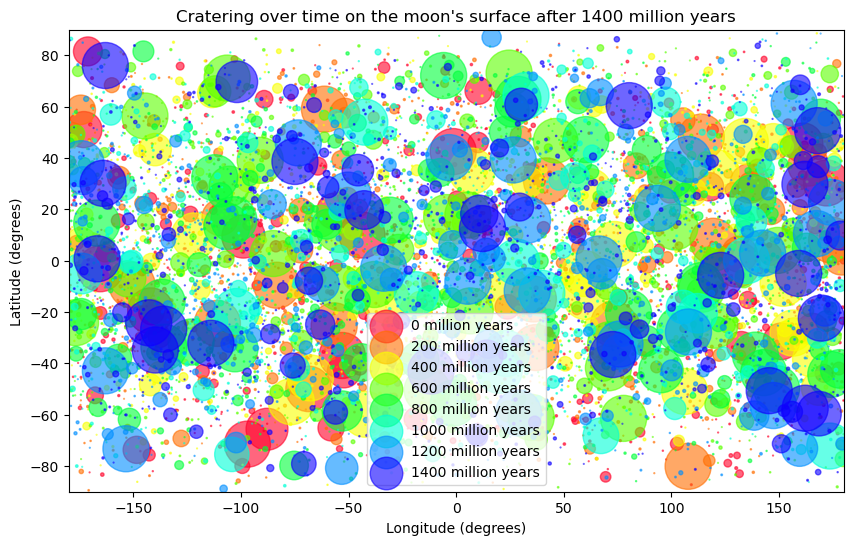

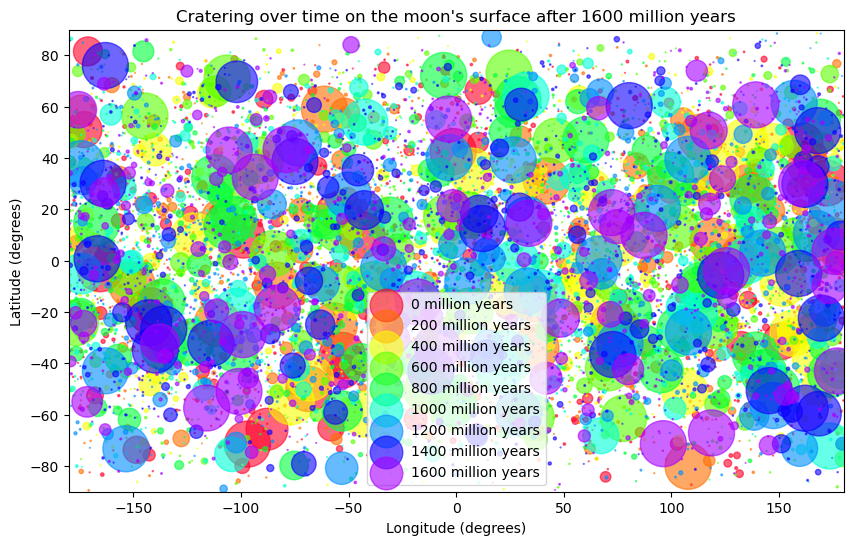

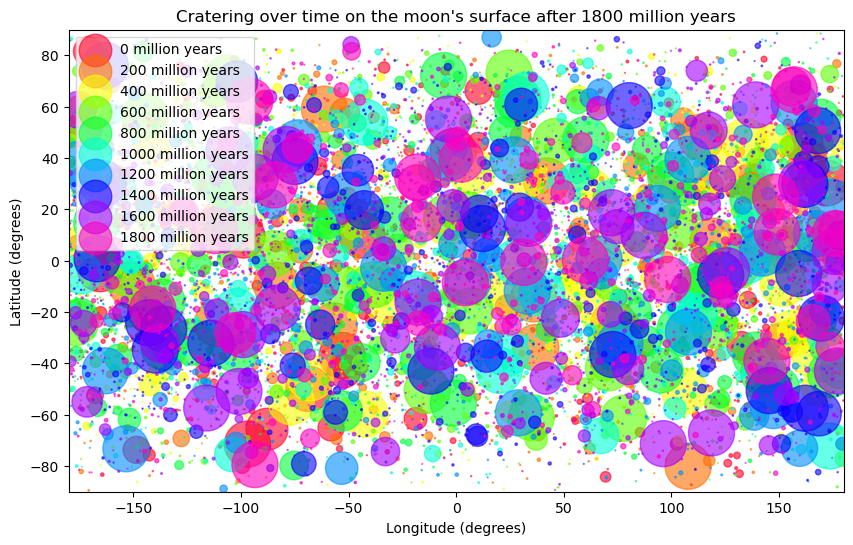

In [46]:
# Run simulation for 10k craters, 20 timesteps
craters, crater_positions = simulate_craters1(lmbda_0_10k)